In [1]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

import community as community_louvain
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from networkx.algorithms.community.centrality import girvan_newman

#from infomap import infomap
#from cdlib import algorithms
#import igraph as ig
#import leidenalg as la

# Load network

In [2]:
df = pd.read_csv('../../../Data/final_cool_dataset.csv')

In [3]:
df.head()

,ORIGIN,DEST,PAYLOAD,DISTANCE,SEATS,PASSENGERS,DEPARTURES_PERFORMED,CARRIER_NAME,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,ORIGIN_NAME,DEST_NAME
0,ABL,OME,10500.0,280.0,4.0,0.0,2.0,['Bering Air Inc.'],10139,13873,"Ambler, AK: Ambler River","Nome, AK: Nome Airport"
1,AIN,OME,4500.0,448.0,19.0,0.0,1.0,['Hageland Aviation Service'],10225,13873,"Wainwright, AK: Wainwright Airport","Nome, AK: Nome Airport"
2,ANC,OME,33729908.0,539.0,31762.0,20623.0,1133.0,['Era Aviation' 'Alaska Airlines Inc.'\n 'Tato...,10299,13873,"Anchorage, AK: Ted Stevens Anchorage Internati...","Nome, AK: Nome Airport"
3,ATK,OME,4500.0,463.0,19.0,0.0,1.0,['Hageland Aviation Service'],10396,13873,"Atqasuk, AK: Atqasuk Edward Burnell Sr. Memorial","Nome, AK: Nome Airport"
4,AUK,OME,39300.0,129.0,26.0,7.0,9.0,['Arctic Transportation' 'Bering Air Inc.' 'Ha...,10416,13873,"Alakanuk, AK: Alakanuk Airport","Nome, AK: Nome Airport"


In [4]:
df.shape

(21149, 12)

In [5]:
edges = [(row['ORIGIN'], row['DEST'], {'weight': row['PASSENGERS']}) for _, row in df.iterrows()]

In [6]:
G = nx.DiGraph()
G.add_edges_from(edges)

In [7]:
G.number_of_edges()

21149

In [8]:
degrees = sorted(G.degree, key=lambda x: x[1], reverse=True) # not considering weights
degrees[:10]

[('ATL', 419),
 ('MSP', 412),
 ('DEN', 403),
 ('ORD', 388),
 ('DFW', 361),
 ('ANC', 344),
 ('MEM', 335),
 ('DTW', 333),
 ('IAH', 327),
 ('LAS', 315)]

# Describing our network
- Degree distribution
- Clustring coefficient (global + local)
- Diameter + average path length (small diameter - everyone is reachable. Large diameter - traversal might be impossible)

Show that our graph is dense, tightly connected.

# Possible measures of importance / centrality

Figure out which nodes / edges are central and peripheral. 

## A) Node measures 
### _Degree-based_: Degree Centrality
The number of links incident upon a node. The degree can be interpreted in terms of the immediate risk of a node for catching whatever is flowing through the network (such as a virus, or some information). Since we have a directed network, we should define both an indegree and outdegree.

In [81]:
# Computing in-degree for nodes in G
sorted_in_degree = sorted(nx.in_degree_centrality(G).items(), key=lambda x: x[1], reverse=True)

# Selecting 10 highest ranking nodes
sorted_in_degree[0:10]

[('ANC', 0.40825688073394495),
 ('HPN', 0.2408256880733945),
 ('FAI', 0.23394495412844038),
 ('BET', 0.19036697247706424),
 ('ACK', 0.13302752293577982),
 ('OME', 0.13073394495412843),
 ('ANI', 0.11009174311926606),
 ('OTZ', 0.10550458715596331),
 ('ADQ', 0.10550458715596331),
 ('SCC', 0.06192660550458716)]

In [105]:
# Computing out-degree for nodes in G
sorted_out_degree = sorted(nx.out_degree_centrality(G).items(), key=lambda x: x[1], reverse=True)

# Selecting 10 highest ranking nodes
sorted_out_degree[:10]

[('ANC', 0.027522935779816515),
 ('BET', 0.027522935779816515),
 ('FAI', 0.02522935779816514),
 ('ADQ', 0.020642201834862386),
 ('ANI', 0.020642201834862386),
 ('GAL', 0.01834862385321101),
 ('UNK', 0.01834862385321101),
 ('ILI', 0.01834862385321101),
 ('OME', 0.016055045871559634),
 ('BRW', 0.016055045871559634)]

### _Degree-based_: Eigenvector centrailty (eigencentrality)
 - Lecture 2
 
Assigns relative scores to all nodes in the network based on the concept that connections to high-scoring nodes contribute more to the score of the node in question than equal connections to low-scoring nodes.

Using the adjacency matrix to find eigenvector centrality: In general, there will be many different eigenvalues 
$\lambda$  for which a non-zero eigenvector solution exists. Since the entries in the adjacency matrix are non-negative, there is a unique largest eigenvalue, which is real and positive, by the Perron–Frobenius theorem. This greatest eigenvalue results in the desired centrality measure. The $v$'th component of the related eigenvector then gives the relative centrality score of the vertex $v$ in the network.

Can we use the eigenvectors to discover 'bridges' between clusters?

For directed graphs, we can use the Eigen Vector Centrality to evaluate the “importance” of a node (based on the out-degree Eigen Vector) and the “prestige” of a node (through the in-degree Eigen Vector).
- A node is considered to be more important if it has out-going links to nodes that in turn have a larger out-degree (i.e., more out-going links).
- A node is considered to have a higher “prestige”, if it has in-coming links from nodes that themselves have a larger in-degree (i.e., more in-coming links).

**OBS**: Is it problematic for directed graphs?? Eigenvector centrality will not take zero in-degree nodes into account in directed graphs. 
_Example_: A new research paper is published and it references a handful of existing papers. It would not contribute to any of those referenced papers in this citation network because it is not cited by any other papers and has zero eigenvector centrality.

### _Shortest-path-based_: Closeness centrailty
Is a measure of centrality in a network, calculated as the reciprocal of the sum of the length of the shortest paths between the node and all other nodes in the graph. The more central a node is, the closer it is to all other nodes.

We must consider taking distances _from_ or _to_ all other nodes, as it can produce very different results in directed graphs (e.g. an airport can have a high closeness centrality from outgoing routes, but low closeness centrality from incoming routes).

In [104]:
# Computing inward distance to a node, using edge weights
sorted_closeness_centraility = sorted(nx.closeness_centrality(G, distance='weights', wf_improved=False).items(), 
                                      key=lambda x: x[1], reverse=True) # wf=True only for disconnected graphs

# Selecting 10 highest ranking nodes
sorted_closeness_centraility[:10]

[('HPN', 0.8301886792452831),
 ('PGA', 0.7931034482758621),
 ('ANC', 0.7132530120481928),
 ('ACK', 0.6407766990291263),
 ('GCN', 0.6216216216216216),
 ('FAI', 0.593186372745491),
 ('BLD', 0.5609756097560976),
 ('VGT', 0.5476190476190477),
 ('L41', 0.5476190476190477),
 ('BET', 0.5471349353049908)]

In [103]:
# Computing outward distance to a node, using edge weights
sorted_closeness_centraility = sorted(nx.closeness_centrality(G.reverse(), distance='weights', wf_improved=False).items(), 
                                      key=lambda x: x[1], reverse=True) # G.reverse() = outward distance, directions reversed

# Selecting 10 highest ranking nodes
sorted_closeness_centraility[:10]

[('ACK', 1.0),
 ('ALB', 1.0),
 ('AUG', 1.0),
 ('BDR', 1.0),
 ('BED', 1.0),
 ('BHB', 1.0),
 ('BOS', 1.0),
 ('BTV', 1.0),
 ('CON', 1.0),
 ('DCA', 1.0)]

### _Shortest-path-based_: Betweenness centrailty (node)  
- Lecture 3

Quantifies the number of times a _node_ acts as a bridge along the shortest path between two other nodes. In his conception, nodes that have a high probability to occur on a randomly chosen shortest path between two randomly chosen vertices have a high betweenness. The measure is related to a network's connectivity - high betweenness nodes have the potential to disconnect graphs if removed.

(Find out which algorithm to use for directed, weighted graph).

In [141]:
# Remove edges with weight zero (or use graph with +1 values, Markus)
G_nonzero = G.copy()
to_remove = [(a,b) for a, b, attrs in G.edges(data=True) if attrs["weight"] <= 0.0]
G_nonzero.remove_edges_from(to_remove)

In [142]:
# Computing betweenness centrality for nodes in G
betweenness = sorted(nx.betweenness_centrality(G_nonzero, normalized=True, weight='weights', endpoints=False, seed=0).items(), 
               key=lambda x: x[1], reverse=True) # set seed to make reproducible 

# Selecting 10 highest ranking nodes
betweenness[:10]

[('ANC', 0.01484295204953228),
 ('FAI', 0.007875536256191093),
 ('BET', 0.006517412529354955),
 ('ADQ', 0.006094341335957912),
 ('HOM', 0.0037865127069492788),
 ('ANI', 0.0024296108826320786),
 ('OME', 0.001401869510854009),
 ('BRW', 0.0009881592624395544),
 ('OTZ', 0.0008466780152955401),
 ('SCC', 0.0006964697897155966)]

### Percolation centrality - Not covered?
Specifically measures the importance of nodes in terms of aiding the percolation through the network. It is defined for a given node, at a given time, as the proportion of ‘percolated paths’ that go through that node. A ‘percolated path’ is a shortest path between a pair of nodes, where the source node is percolated (e.g., infected). The target node can be percolated or non-percolated, or in a partially percolated state.

### Local Clustering coefficcient
The global version gives an overall indication of the clustering in the network, whereas the local gives an indication of the embeddedness of single nodes.

## B) Edge measures 

#### Betweenness centrailty (edge)
The number of the shortest paths to go through an _edge_ in a graph or network (Girvan and Newman). An edge with a high edge betweenness centrality score represents a bridge-like connector between two parts of a network (as with node betweenness centrailty), where the removal may affect the 'communication' between many pairs of nodes through the shortest paths between them.

In [170]:
# Computing betweenness centrality for edges in G
edge_betweenness = [(k, v) for k, v in sorted(nx.edge_betweenness_centrality(G, normalized=True, weight='weights', seed=0).items(), key=lambda item: item[1], reverse=True)]

# Selecting 10 highest ranking edges
edge_betweenness[:10]

[(('ANC', 'ADQ'), 0.002080490416308021),
 (('ANC', 'HOM'), 0.0019401985672743336),
 (('ANC', 'ANI'), 0.0016687985420271864),
 (('ANI', 'RSH'), 0.0015535448113702687),
 (('HOM', 'SOV'), 0.0015404236558688306),
 (('HOM', 'KEB'), 0.0015377994247685429),
 (('ADQ', 'KOY'), 0.0015194298070665296),
 (('ADQ', 'ALZ'), 0.0014958117271639411),
 (('ADQ', 'OLH'), 0.0014958117271639411),
 (('FAI', 'ADQ'), 0.0014927368705211802)]

# Community Discovery

### CD: Girvan-Newman
Communities are discovered by iteratively removing the "most valuable" edges of the graph. This value is based on the edge betweenness centrality (the number of shortest paths that pass through an edge)

In [56]:
communities = girvan_newman(G)

In [57]:
node_groups = []
for com in next(communities):
    node_groups.append(list(com))

In [58]:
print('no. of communities:', len(node_groups))

no. of communities: 2


In [48]:
node_groups

[['MDO',
  'JZM',
  'HNL',
  'TLA',
  'SOV',
  'PGM',
  'IND',
  'PML',
  'WWT',
  'KEK',
  'KMO',
  '06A',
  'ANC',
  'MOU',
  'RFD',
  'NIN',
  '05A',
  'SHH',
  'CHS',
  'WWA',
  'LNI',
  'ALZ',
  'NNL',
  'SIT',
  'BUR',
  'SAT',
  'ORI',
  'FVZ',
  'ORT',
  'MEM',
  'FYU',
  'GUM',
  'BKC',
  'KKB',
  'KEB',
  'ATT',
  'CXF',
  'KNW',
  'WBB',
  'KOZ',
  'CDB',
  'A52',
  'PAQ',
  'CIK',
  'BIS',
  'PTU',
  'GEG',
  'RSH',
  'EMK',
  'SNP',
  'IAN',
  'AIN',
  'IRC',
  'ORV',
  'OBU',
  'AUS',
  'WTL',
  'DRG',
  'LMA',
  'KYK',
  'NUI',
  'NUL',
  'KOT',
  'A71',
  'DGB',
  'DIO',
  'A40',
  'SMK',
  'IKO',
  'NME',
  'AKK',
  'KGX',
  'OHC',
  'RQI',
  'ARC',
  'KOA',
  'VEE',
  'KOY',
  'A14',
  'HPB',
  'MRI',
  'KBC',
  'MCG',
  'BFB',
  'KAL',
  'KZB',
  'A03',
  'AKP',
  'GMT',
  'KSM',
  'EEK',
  'GLV',
  'IGG',
  'AKI',
  'KPV',
  'KQA',
  'SKK',
  'KVL',
  'BVU',
  'TAL',
  'SFO',
  'RDB',
  'HUS',
  'KGK',
  'SVS',
  'HGZ',
  'SRV',
  'MSP',
  'ANV',
  'HCR',
  'LUR',
 

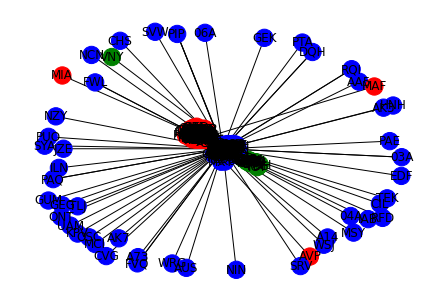

In [35]:
color_map = []
for node in G:
    if node in node_groups[0]:
        color_map.append('blue')
    elif node in node_groups[1]:
        color_map.append('red')
    else: 
        color_map.append('green')  
nx.draw(G, node_color=color_map, with_labels=True)
plt.show()

### CD: Label Propagation
Each node in the network is first given a unique label; at each iteration, each node is updated by choosing the label which is the most frequent among its neighbors – if multiple choices are possible, one label is picked randomly. The algorithm halts when each node has the label that appears most frequently among its neighbors. 

The algorithm below is asynchronous: only one node is updated at each iteration without waiting for updates on the remaining nodes. The algorithm is not deterministic. It is probabilistic and the found communities may vary for each different executions.

**Asynchronous vs. Synchronous**
- Asynchronous model: Label propagation step is performed **sequentailly** on all nodes. Updating where $C_x(t)=f(C_{xi1}(t),...,C_{xim}(t),C_{xi}(m+1)(t−1),...,C_{xik}(t−1))$ and $x_{i1},...,x_{im}$ are neighbors of $x$ that have already been updated in the current iteration while $x_i(m+1),...,x_{ik}$ are neighbors that are not yet updated in the current iteration. The order in which all the $n$ nodes in the network are updated at each iteration is chosen randomly
- Synchronous model: Label propagation step is performed **in parallel** on all nodes. Each node computes its label at step $i$ based on the label of its neighbors at step $i − 1$.


(The semi-synchronous version of this algorithm does not work for directed graphs). 



The label propagation algorithm can be either synchronous, as presented above, or asynchronous. In the synchronous model (cf. Algorithm 1) each vertex computes its label at


**From litterature: https://arxiv.org/pdf/1103.4550.pdf**:

The community detection strategy based on a label propagation algorithm (LPA) identifies network partitions by an “epidemic” approach, i.e., it uses the diffusion of information in the network to identify communities => this is why this CD algo could be relevant for our project!

https://www.sciencedirect.com/science/article/pii/S0378437116301807
https://arxiv.org/pdf/0709.2938.pdf 

In [9]:
label_prob = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight', seed=0))

In [10]:
len(label_prob)

15

In [11]:
label_prob

[{'04A',
  '06A',
  '08A',
  '1N7',
  '7AK',
  'A26',
  'A27',
  'A29',
  'A40',
  'A63',
  'ABE',
  'ABI',
  'ABL',
  'ABQ',
  'ABR',
  'ABY',
  'ACT',
  'ACV',
  'ACY',
  'ADK',
  'ADQ',
  'ADS',
  'ADW',
  'AET',
  'AEX',
  'AFK',
  'AFW',
  'AGC',
  'AGN',
  'AGS',
  'AHN',
  'AIA',
  'AIN',
  'AK5',
  'AK7',
  'AKB',
  'AKK',
  'AKN',
  'AKP',
  'ALB',
  'ALO',
  'ALS',
  'ALW',
  'ALZ',
  'AMA',
  'ANB',
  'ANC',
  'AND',
  'ANI',
  'ANP',
  'ANV',
  'AOO',
  'AOS',
  'APA',
  'APC',
  'APF',
  'APN',
  'ARA',
  'ARC',
  'ART',
  'ASE',
  'ASH',
  'ASN',
  'ATK',
  'ATL',
  'ATS',
  'ATW',
  'ATY',
  'AUG',
  'AUS',
  'AVL',
  'AVP',
  'AXV',
  'AZO',
  'BAF',
  'BBW',
  'BCE',
  'BDL',
  'BED',
  'BEH',
  'BFB',
  'BFD',
  'BFF',
  'BFI',
  'BFL',
  'BFM',
  'BFT',
  'BGM',
  'BGR',
  'BHB',
  'BHM',
  'BIF',
  'BIH',
  'BIL',
  'BIS',
  'BJC',
  'BJI',
  'BKC',
  'BKG',
  'BKL',
  'BKW',
  'BLI',
  'BLV',
  'BMG',
  'BMI',
  'BNA',
  'BOI',
  'BOS',
  'BPT',
  'BQK',
  'BRD',
 

In [12]:
nx.algorithms.community.modularity(G, label_prob, weight='weight')

0.002264182732026436

In [13]:
def LP_generator(graph, coms, iterations):
    '''
    Function which compares ...
    '''
    
    #lp_coms = list(nx.community.label_propagation.asyn_lpa_communities(graph, weight='weight', seed=0))
    unequal = 0

    for _ in range(iterations):
        for i in range(len(coms)):
            lp_test = list(nx.community.label_propagation.asyn_lpa_communities(graph, weight='weight')) # don't set seed for this
            if (coms[i] ^ lp_test[i]): # there is a difference
                unequal += 1
            else: # there is no difference
                pass
    print('All communities are the same:', unequal == 0)

In [14]:
coms = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight', seed=0))
LP_generator(G, coms, 2)

IndexError: list index out of range

In [199]:
lp_coms = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight', seed=0))

In [15]:
for i in range(10):
    lp_coms = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight'))
    print(len(lp_coms))

13
13
14
15
15
14
14
15
13
15


In [182]:
lp_coms = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight'))
unequal = 0

for _ in range(10):
    for i in range(len(lp_coms)):
        lp_test = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight')) # don't set seed for this
        if (lp_coms[i] ^ lp_test[i]): # there is a difference
            print('there is a difference')
            #unequal += 1
        else: # there is no difference
            pass

In [166]:
s1 = [{3,2},{4,5}]
s2 = [{1,2},{4,5}]

In [167]:
for i in range(len(s1)):
    if (s1[i] ^ s2[i]):
        print('there is a difference')
    else:
        print('there is no difference')

there is a difference
there is no difference


In [129]:
test = [[{1,3},{4,5}],[{3,2},{4,5}]]

In [143]:
for i in range(len(test)):
    for j in i:
        print(test[0][j].difference(test[1][j]))


TypeError: 'int' object is not iterable

In [220]:
from collections import Counter
lp_coms = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight', seed=0))
unequal = 0
diff_comm = []
for _ in range(10):
    lp_test = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight'))
    # don't set seed for this
    if len(lp_coms) == len(lp_test):
        for i in range(len(lp_test)):
            if (coms[i] ^ lp_test[i]): # there is a difference
                unequal += 1
            else: # there is no difference
                    pass
    else:
        diff_comm.append(len(lp_test) - len(lp_coms))
print(Counter(diff_comm))

Counter({-2: 2, 1: 2, 2: 1, -3: 1, -1: 1})


In [ ]:
{'AFK': {0: 0, 1: 2, 2: 1, 3: 1, 4: 1}}

# for each interation: 
# re-define communities
# check if there are the same amaount of 

In [19]:
lp_coms = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight', seed=0))
counter = 0
set_nodes = set(G.nodes())
dict_com = dict()
for i in lp_coms:
    print(i[0])
    
    #    counter +=1
#print(counter)

TypeError: 'set' object is not subscriptable

In [36]:
lp_coms = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight', seed = 0))

In [39]:
colors = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000']

In [73]:
dictresult = dict()
list_comm = []
for _ in range(10):
    lp_test = list(nx.community.label_propagation.asyn_lpa_communities(G, weight='weight'))
    for i in G.nodes():
        for j in range(len(lp_test)):
            if i in lp_test[j]:
                dictresult.setdefault(i,[]).append(j)

In [74]:
dictresult

{'ABL': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'OME': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'AIN': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'ANC': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'ATK': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'AUK': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
 'BET': [2, 1, 1, 1, 1, 1, 1, 1, 1, 2],
 'BKC': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'BRW': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'CIL': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'DIO': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'DRG': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'ELI': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'EMK': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
 'FAI': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'FBK': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'GAL': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'GAM': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'GLV': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'GMT': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'HPB': [2, 1, 1, 1, 1, 1, 1, 1, 1, 2],
 'HSL': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'IAN': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'KAL': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'KKA': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],


In [88]:
dict_shared = dict()
for i in range(10):
    for A1 in dictresult.keys():
        for A2 in dictresult.keys():
            if dictresult[A1][i] == dictresult[A2][i]:
                dict_shared.setdefault(A1, []).append(A2)
            
        

In [91]:
from collections import Counter

In [92]:
dict_final = dict()
for i,j in dict_shared.items():
    dict_final[i] = Counter(j)

In [93]:
dict_final

{'ABL': Counter({'ABL': 10,
          'OME': 10,
          'AIN': 10,
          'ANC': 10,
          'ATK': 10,
          'BKC': 10,
          'BRW': 10,
          'CIL': 10,
          'DIO': 10,
          'DRG': 10,
          'ELI': 10,
          'FAI': 10,
          'FBK': 10,
          'GAL': 10,
          'GAM': 10,
          'GLV': 10,
          'GMT': 10,
          'HSL': 10,
          'IAN': 10,
          'KAL': 10,
          'KKA': 10,
          'KPC': 10,
          'KSM': 2,
          'KTS': 10,
          'KVL': 10,
          'MCG': 10,
          'MOS': 10,
          'OBU': 10,
          'OHC': 10,
          'ORV': 10,
          'OTZ': 10,
          'PHO': 10,
          'RBY': 10,
          'SHH': 10,
          'SKK': 10,
          'SMK': 10,
          'SVA': 10,
          'TLA': 10,
          'TNC': 10,
          'UNK': 10,
          'VEE': 10,
          'WAA': 10,
          'WBB': 10,
          'WLK': 10,
          'WMO': 10,
          'WTK': 10,
          '04A': 10,
       